In [11]:
import uproot
from tqdm import tqdm
import numpy as np
import pandas as pd
from uproot_methods.classes.TLorentzVector import TLorentzVector

In [3]:
f = uproot.open('/global/cscratch1/sd/schuya/mass_regression/data/fine_higgs/raw_root/output_H_to_WlnuWlnu.1000.root')

In [4]:
f.keys()

[b'HistPlot;1', b'TreePlot;1', b'event;1']

In [5]:
events = f['event;1']

In [6]:
events

<TTree b'event' at 0x2aaad3e5b750>

In [7]:
events.keys()

[b'H_Mass',
 b'H_Gen',
 b'Wa_Gen',
 b'Wb_Gen',
 b'La_Vis',
 b'Na_Gen',
 b'Lb_Vis',
 b'Nb_Gen',
 b'MET_X_Vis',
 b'MET_Y_Vis',
 b'H',
 b'Wa',
 b'Wb',
 b'Na',
 b'Nb']

In [12]:
df = pd.DataFrame()
for k, v in tqdm(events.items(), total=len(events.keys())):
    name = k.decode('ascii')
    values = v.array()
    if type(values[0]) is TLorentzVector:
        x = np.zeros(values.shape)
        y = np.zeros(values.shape)
        z = np.zeros(values.shape)
        E = np.zeros(values.shape)
        m = np.zeros(values.shape)
        for i, vec in enumerate(values):
            x[i] = vec.x
            y[i] = vec.y
            z[i] = vec.z
            E[i] = vec.t
            try:
                m[i] = vec.mass
            except:
                m[i] = 0.0
        df[f'{name}x'] = x
        df[f'{name}y'] = y
        df[f'{name}z'] = z
        df[f'{name}E'] = E
        df[f'{name}m'] = m
    else:
        df[name] = values
df = df.astype('float32')

100%|██████████| 15/15 [01:15<00:00,  5.01s/it]


In [16]:
df.columns

Index(['H_Mass', 'H_Genx', 'H_Geny', 'H_Genz', 'H_GenE', 'H_Genm', 'Wa_Genx',
       'Wa_Geny', 'Wa_Genz', 'Wa_GenE', 'Wa_Genm', 'Wb_Genx', 'Wb_Geny',
       'Wb_Genz', 'Wb_GenE', 'Wb_Genm', 'La_Visx', 'La_Visy', 'La_Visz',
       'La_VisE', 'La_Vism', 'Na_Genx', 'Na_Geny', 'Na_Genz', 'Na_GenE',
       'Na_Genm', 'Lb_Visx', 'Lb_Visy', 'Lb_Visz', 'Lb_VisE', 'Lb_Vism',
       'Nb_Genx', 'Nb_Geny', 'Nb_Genz', 'Nb_GenE', 'Nb_Genm', 'MET_X_Vis',
       'MET_Y_Vis', 'Hx', 'Hy', 'Hz', 'HE', 'Hm', 'Wax', 'Way', 'Waz', 'WaE',
       'Wam', 'Wbx', 'Wby', 'Wbz', 'WbE', 'Wbm', 'Nax', 'Nay', 'Naz', 'NaE',
       'Nam', 'Nbx', 'Nby', 'Nbz', 'NbE', 'Nbm'],
      dtype='object')

In [15]:
import plotly.express as px

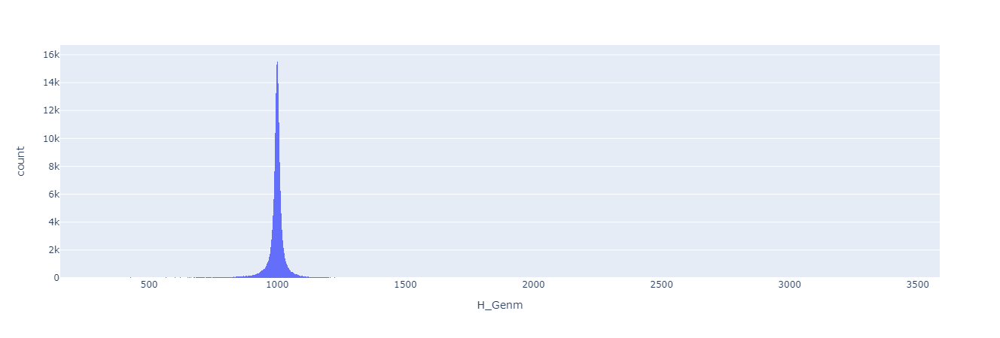

In [18]:
px.histogram(df, x='H_Genm')